# [IAPR][iapr]: Lab 1 ‒  Image segmentation  
  

**Release date:** 8.03.2023  
**Due date:** 24.03.2022 (11:59 pm)


## Important notes

The lab assignments are designed to teach practical implementation of the topics presented during class well as
preparation for the final project, which is a practical project which ties together the topics of the course.

As such, in the lab assignments/final project, unless otherwise specified, you may, if you choose, use external
functions from image processing/ML libraries like opencv and sklearn as long as there is sufficient explanation
in the lab report. For example, you do not need to implement your own edge detector, etc.

**! Before handling back the notebook <font color='red'> rerun </font>the notebook from scratch !**
`Kernel` > `Restart & Run All`

We will not rerun the notebook for you.

[iapr]: https://github.com/LTS5/iapr

---
## 0. Extract relevant data
We first need to extract the `lab-01-data.tar.gz` archive.
To this end, we use the [tarfile] module from the Python standard library.

[tarfile]: https://docs.python.org/3.6/library/tarfile.html

In [1]:
import tarfile
import os

data_base_path = os.path.join(os.pardir, 'data')
print(data_base_path)
data_folder = 'lab-01-data'
tar_path = os.path.join(data_base_path, data_folder + '.tar.gz')

if not os.path.exists(tar_path):
    raise Exception('Path to is not valid {}'.format(tar_path))
    
with tarfile.open(tar_path, mode='r:gz') as tar:
    tar.extractall(path=data_base_path)

..\data


In [2]:
import numpy as np

import cv2

import skimage.io
from skimage.exposure import histogram
from skimage.color import rgb2hsv
from skimage.morphology import closing, opening, disk, remove_small_holes, remove_small_objects, binary_dilation, binary_erosion
from skimage.restoration import denoise_wavelet, estimate_sigma
from skimage.filters import gaussian, butterworth, unsharp_mask
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.util import img_as_ubyte
from skimage.filters import threshold_otsu, threshold_mean, threshold_minimum, threshold_multiotsu

from scipy import signal

import matplotlib.pyplot as plt
%matplotlib inline

---
## Part 1: Segmentation


### 1.0 Intro

In this exercise, you will be given two images. 

* `mucinous_adeno.jpg`: The image depicts a tissue sample from mucinous adenocarcinoma in colorectal cancer. The data is taken from the Cancer Genome Atlas (TCGA) which is an open-source database of different cancer types. Here you can see a tissue taken from a patient and stained using hematoxylin (purple) and eosin (pink) staining. The hematoxylin stains cell nuclei with a purplish blue, and the eosin stains the extracellular matrix and cytoplasm in pink.

* `mucinous_adeno_gt.jpg`: The second image is a coarse annotation of what is regarded as the so-called mucinous area. The mucinous area can be identified as a gray area tainted with purple. The presence of a large amount of mucin is a sign of a defect of normal epithelial cells that start to produce an unreasonable amount of mucin.


### 1.1 Tasks

You will be asked to extract the mucinous area using various approaches:

- [ ] Thresholding
- [ ] Morphology
- [ ] Region growing


### 1.1 Brain image visualization

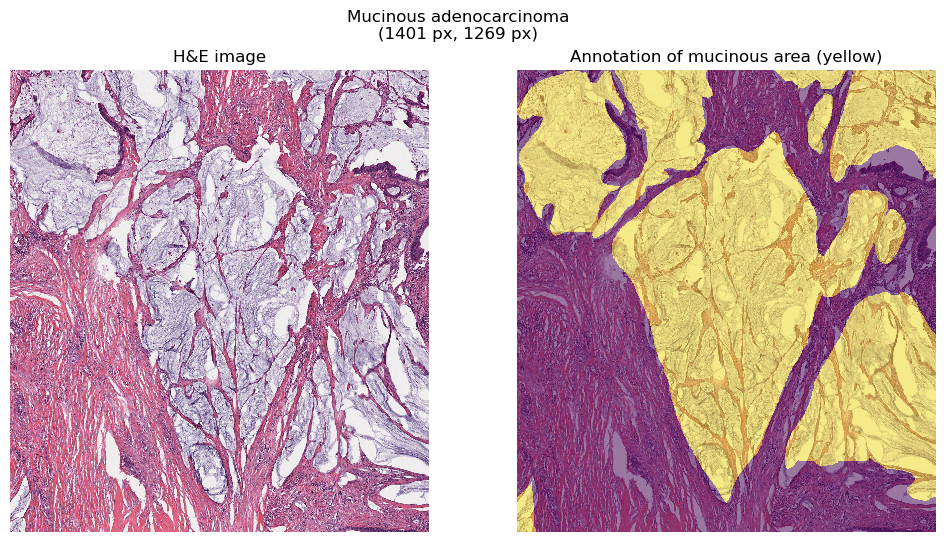

In [3]:
# loading the images
path_to_image = os.path.join(data_base_path, data_folder, "mucinous_adeno.jpg")
path_to_gt = os.path.join(data_base_path, data_folder, "mucinous_adeno_gt.jpg")
adeno_img = skimage.io.imread(path_to_image)
adeno_gt = skimage.io.imread(path_to_gt) > 128

# getting the size of the image in px
im_h, im_w, im_c = adeno_img.shape

# displaying the MRI image
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# plotting the image
ax[0].imshow(adeno_img, interpolation='nearest')
ax[0].set_title('H&E image'.format(im_h, im_w))
ax[0].axis('off')

# plotting the image with overlay
ax[1].imshow(adeno_img, interpolation='nearest')
ax[1].imshow(adeno_gt, alpha=0.5, interpolation='nearest')
ax[1].set_title('Annotation of mucinous area (yellow)')
ax[1].axis('off')
plt.suptitle("Mucinous adenocarcinoma\n({} px, {} px)".format(im_h, im_w))
plt.show()

---
### 1.2 Thresholding (4pts)
#### 1.2.1 RGB & Hue (1 pts)

Display the histogram for each channel (R, G, and B) as well as the histogram for the H (hue) channel. Note that you can use [rgb2hsv](https://scikit-image.org/docs/stable/api/skimage.color.html#skimage.color.rgb2hsv) to convert an RGB image to an HSV image and then extract the hue.

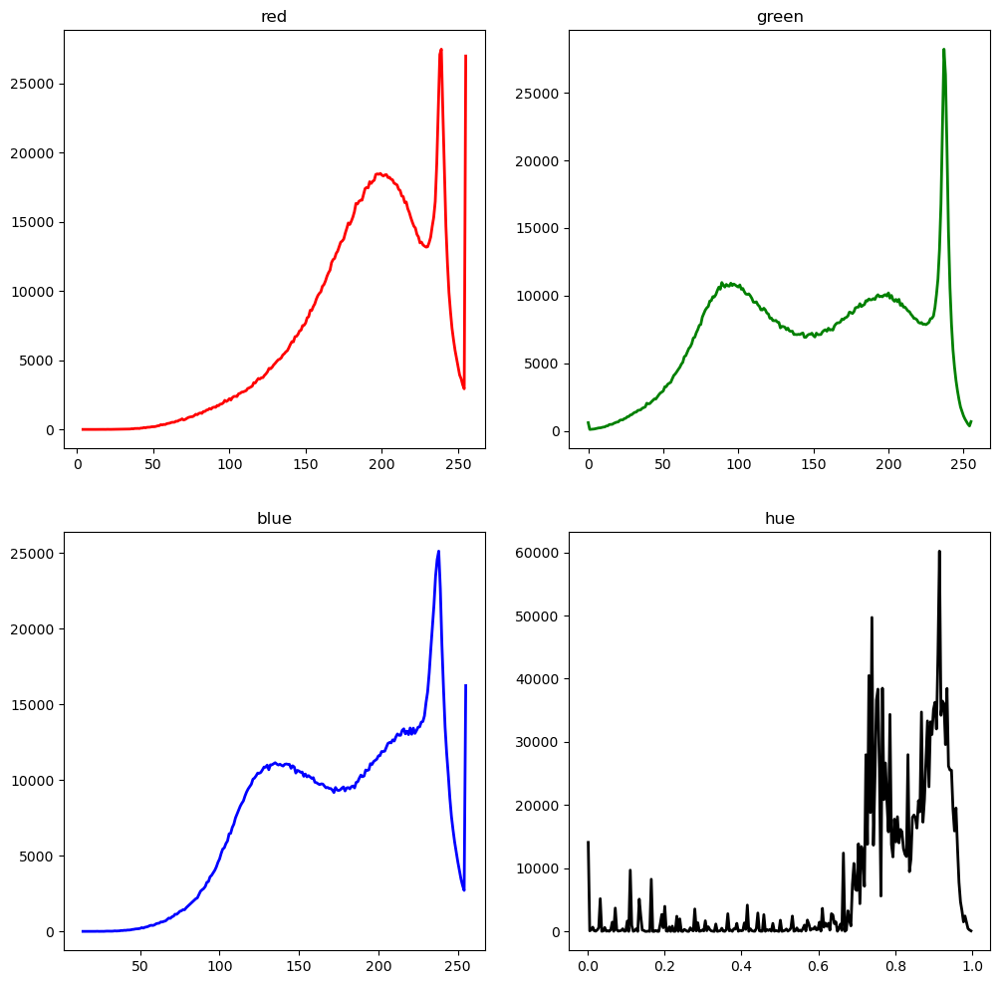

In [4]:
# extracting the histogram of each r, g, and b channels
hist_r, hist_centers_r = histogram(adeno_img[:, :, 0], nbins=256)
hist_g, hist_centers_g = histogram(adeno_img[:, :, 1], nbins=256)
hist_b, hist_centers_b = histogram(adeno_img[:, :, 2], nbins=256)

# converting image to HSV and extracting the hue channel
adeno_hsv = rgb2hsv(adeno_img)
hist_h, hist_centers_h = histogram(adeno_hsv[:, :, 0])

# putting all the histograms together
hist_dict = {'red': (hist_r, hist_centers_r), 'green': (hist_g, hist_centers_g), 'blue': (hist_b, hist_centers_b), 'hue': (hist_h, hist_centers_h)}

# plotting the histograms
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
for c, c_color in enumerate(('red', 'green', 'blue', 'hue')):
    ax = axes.ravel()[c]
    ax.plot(hist_dict[c_color][1], hist_dict[c_color][0], lw=2, c=c_color if c_color != 'hue' else 'black')
    ax.set_title(c_color)
plt.show()

#### 1.2.2 Apply Thresholding (2 pts)

For each histogram find the threshold(s) that work the best to isolate the mucinous area. Display the image after thresholding of each channel as well as the error between your prediction ($im$) and the annotations ($gt$) using the formula:

$$error = 1 - \left( \frac{1}{IJ} \sum_{i,j} im_{i,j} == gt_{i, j} \right)$$

Here, I and J are the dimension of the image.

In [5]:
def calc_err(pred, annot):
    return 1 - (np.sum(pred==annot)/(pred.shape[0]*pred.shape[1]))

**First Method:** Set the thereshold manually based on histogram visualization. This method gives the best result based on error calculation.

Error for red channel: 0.44802232335453285
Error for green channel: 0.2621464236116384
Error for blue channel: 0.45233703945566295
Error for hue channel: 0.20062951769787318


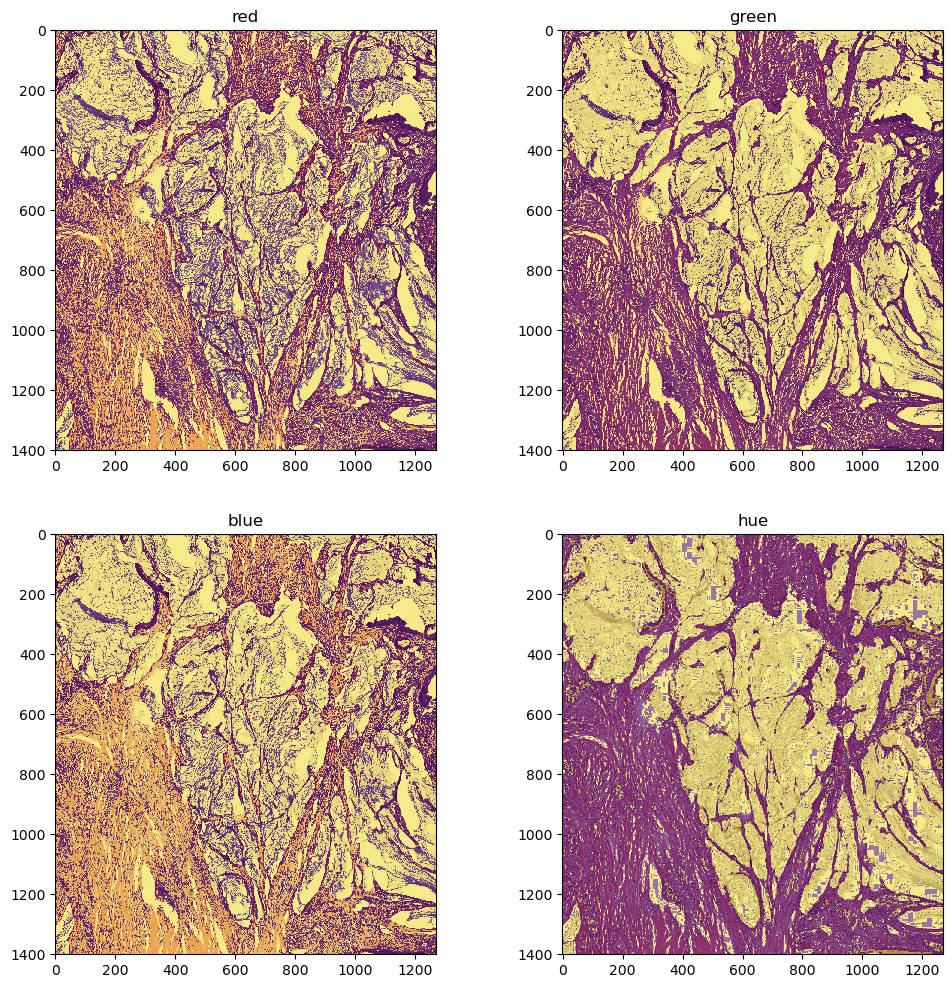

In [6]:
# finding the threshold for the red channel to isolate the mucinous area
red_mask = np.where((adeno_img[:, :, 0]>193) & (adeno_img[:, :, 0]<256), 1, 0).astype(bool)
print('Error for red channel: {}'.format(calc_err(red_mask, adeno_gt)))

# finding the threshold for the green channel to isolate the mucinous area
green_mask = np.where((adeno_img[:, :, 1]>145) & (adeno_img[:, :, 0]<256), 1, 0).astype(bool)
print('Error for green channel: {}'.format(calc_err(green_mask, adeno_gt)))

# finding the threshold for the blue channel to isolate the mucinous area
blue_mask = np.where((adeno_img[:, :, 0]>177) & (adeno_img[:, :, 0]<256), 1, 0).astype(bool)
print('Error for blue channel: {}'.format(calc_err(blue_mask, adeno_gt)))

# finding the threshold for the hue channel to isolate the mucinous area
hue_mask = np.where((adeno_hsv[:, :, 0]>=0) & (adeno_hsv[:, :, 0]<0.84), 1, 0).astype(bool)
print('Error for hue channel: {}'.format(calc_err(hue_mask, adeno_gt)))

# putting all the masks together
mask_dict = {'red': red_mask, 'green': green_mask, 'blue': blue_mask, 'hue': hue_mask}

# plotting the masks on the image
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
for c, c_color in enumerate(('red', 'green', 'blue', 'hue')):
    ax = axes.ravel()[c]
    ax.imshow(adeno_img, interpolation='nearest')
    ax.imshow(mask_dict[c_color], alpha=0.5, interpolation='nearest')
    ax.set_title(c_color)
plt.show()


**Other Methods**: Otsu, Mean, and Minimum.

In [7]:
## 2. Otsu's method

# thresh_otsu_red = threshold_otsu(adeno_img_red)
# binary_red_otsu = adeno_img_red > thresh_otsu_red

# thresh_otsu_green = threshold_otsu(adeno_img_green)
# binary_green_otsu = adeno_img_green > thresh_otsu_green

# thresh_otsu_blue = threshold_otsu(adeno_img_blue)
# binary_blue_otsu = adeno_img_blue > thresh_otsu_blue

# Error of Red with Otsu's method = 0.4508133051422799
# Error of Green with Otsu's method = 0.26312849821893514
# Error of Blue with Otsu's method = 0.27391050746708556

## 3. Mean method

# thresh_mean_red = threshold_mean(adeno_img_red)
# binary_red_mean = adeno_img_red > thresh_mean_red

# thresh_mean_green = threshold_mean(adeno_img_green)
# binary_green_mean = adeno_img_green > thresh_mean_green

# thresh_mean_blue = threshold_mean(adeno_img_blue)
# binary_blue_mean = adeno_img_blue > thresh_mean_blue

# Error of Red with Mean's method = 0.44820175164761855
# Error of Green with Mean's method = 0.2635863497254297
# Error of Blue with Mean's method = 0.2740640620878141

## 4. Minimum method

# thresh_minimum_red = threshold_minimum(adeno_img_red)
# binary_red_minimum = adeno_img_red > thresh_minimum_red

# thresh_minimum_green = threshold_minimum(adeno_img_green)
# binary_green_minimum = adeno_img_green > thresh_minimum_green

# thresh_minimum_blue = threshold_minimum(adeno_img_blue)
# binary_blue_minimum = adeno_img_blue > thresh_minimum_blue

# Error of Red with Minimum's method = 0.48416615622410875
# Error of Green with Minimum's method = 0.2622949159921232
# Error of Blue with Minimum's method = 0.2745961597845511

#### 1.2.3 Best Thresholding (1 pts)

Based on your previous findings, set the best threshold(s) and create the final mask as the variable `mask_thesholding`

In [8]:
# combining the masks
mask_thresholding = np.zeros_like(adeno_gt).astype(np.int32)
for c, c_color in enumerate(('red', 'green', 'blue', 'hue')):
    mask_thresholding = mask_thresholding + mask_dict[c_color]
mask_thresholding = np.where(mask_thresholding>0, 1, 0)
print('Error for thresholding for combining masks: {}'.format(calc_err(mask_thresholding, adeno_gt)))

# best mask is the hue mask based on the error calculation
mask_thresholding = hue_mask
print('Error for thresholding for hue mask: {}'.format(calc_err(mask_thresholding, adeno_gt)))

Error for thresholding for combining masks: 0.38158941969290205
Error for thresholding for hue mask: 0.20062951769787318


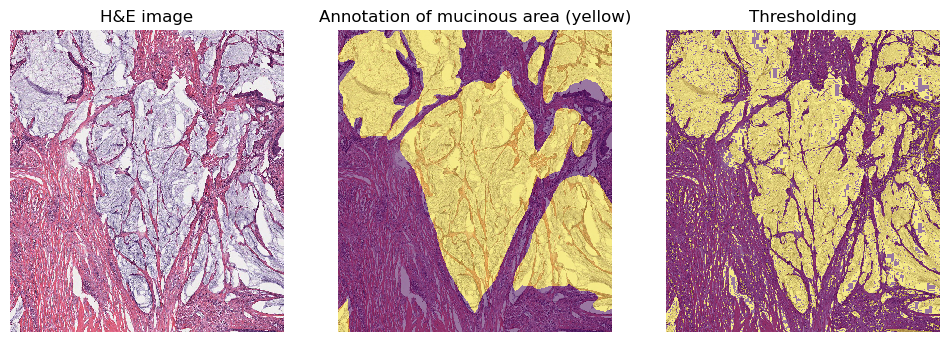

In [9]:
# displaying the MRI image
fig, ax = plt.subplots(1, 3, figsize=(12, 5))

# plotting the images
ax[0].imshow(adeno_img, interpolation='nearest')
ax[0].set_title('H&E image'.format(im_h, im_w))
ax[0].axis('off')
ax[1].imshow(adeno_img, interpolation='nearest')
ax[1].imshow(adeno_gt, alpha=0.5, interpolation='nearest')
ax[1].set_title('Annotation of mucinous area (yellow)')
ax[1].axis('off')
ax[2].imshow(adeno_img, interpolation='nearest')    # changed
ax[2].imshow(mask_thresholding, alpha=0.5, interpolation='nearest')
ax[2].set_title('Thresholding')
ax[2].axis('off')
plt.show()

---

### 1.3 Morphology (5pts)

To proceed, use the best results of the previous model (namely `mask_thesholding`) as the starting point. In this exercise we will try to clean the mask using morphology.

* A (2pts): Try the following operation [closing](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.closing), [opening](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.opening) with [disk](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.disk) size of: $1, 2, 5, 10$. Comment on the quality of the results.

* B (2pts): Try the following operation [remove_small_holes](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.remove_small_holes), [remove_small_objects](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.remove_small_objects) with size of: $10, 50, 100, 500$. Comment on the quality of the results.

* C (1pts): Based on your previous results, can you find a combination of the functions that improve your results? Plot the best result along with the error rate. Save the mask as the variable `mask_morph`

cl_1: 0.1902
op_1: 0.1929
rsh_10: 0.1957
rso_10: 0.1969
cl_2: 0.1828
op_2: 0.1863
rsh_50: 0.1829
rso_50: 0.1846
cl_5: 0.1916
op_5: 0.2122
rsh_100: 0.1790
rso_100: 0.1790
cl_10: 0.3196
op_10: 0.3366
rsh_500: 0.1716
rso_500: 0.1682

error for the best combination = 0.107976


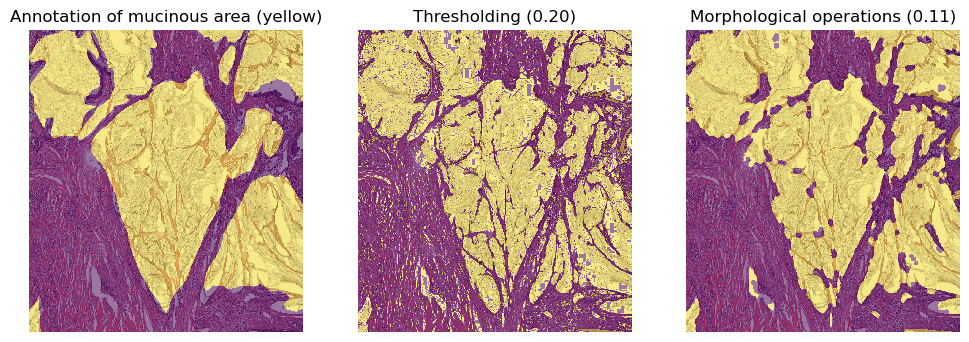

In [10]:
# A and B
# cl: closing, op: openning, rsh: remove small holes, rso: remove small objects
disk_size_arr = [1, 2, 5, 10]
remove_size_arr = [10, 50, 100, 500]
morp_result_dict = {}
for i in range(len(disk_size_arr)):
    morp_result_dict['cl_'+str(disk_size_arr[i])] = closing(mask_thresholding, disk(disk_size_arr[i]))
    print('cl_{:d}: {:.4f}'.format(disk_size_arr[i], calc_err(morp_result_dict['cl_'+str(disk_size_arr[i])], adeno_gt)))
    morp_result_dict['op_'+str(disk_size_arr[i])] = opening(mask_thresholding, disk(disk_size_arr[i]))
    print('op_{:d}: {:.4f}'.format(disk_size_arr[i], calc_err(morp_result_dict['op_'+str(disk_size_arr[i])], adeno_gt)))
    morp_result_dict['rsh_'+str(remove_size_arr[i])] = remove_small_holes(mask_thresholding, remove_size_arr[i])
    print('rsh_{:d}: {:.4f}'.format(remove_size_arr[i], calc_err(morp_result_dict['rsh_'+str(remove_size_arr[i])], adeno_gt)))
    morp_result_dict['rso_'+str(remove_size_arr[i])] = remove_small_objects(mask_thresholding, remove_size_arr[i])
    print('rso_{:d}: {:.4f}'.format(remove_size_arr[i], calc_err(morp_result_dict['rso_'+str(remove_size_arr[i])], adeno_gt)))

# C 
# the numbers below are chosen based on the printed calculated errors below the cell
temp = mask_thresholding
temp = remove_small_holes(temp, 500)
temp = opening(temp, disk(2))
temp = remove_small_objects(temp, 500)
temp = closing(temp, disk(10))
print('\nerror for the best combination = {:4f}'.format(calc_err(temp, adeno_gt)))
mask_morph = temp 

# plot the results
# errors are shown in between paranthesis next to the titles
fig, ax = plt.subplots(1, 3, figsize=(12, 12))
ax[0].imshow(adeno_img, interpolation='nearest')
ax[0].imshow(adeno_gt, alpha=0.5, interpolation='nearest')
ax[0].set_title('Annotation of mucinous area (yellow)')
ax[0].axis('off')
ax[1].imshow(adeno_img, interpolation='nearest')    
ax[1].imshow(mask_thresholding, alpha=0.5, interpolation='nearest')
ax[1].set_title('Thresholding ({:.2f})'.format(calc_err(mask_thresholding, adeno_gt)))
ax[1].axis('off')
ax[2].imshow(adeno_img, interpolation='nearest')
ax[2].imshow(mask_morph, alpha=0.5, interpolation='nearest')
ax[2].set_title('Morphological operations ({:.2f})'.format(calc_err(mask_morph, adeno_gt)))
ax[2].axis('off')
plt.show()

Note that, the numbers used to based the best combination have been chosen among the given sets of numbers, i.e, (1, 2, 5, 10) and (10, 50, 100, 500). Better results can be obtained by choosing other numbers; however, following what one of the assistants told us, we sticked to the given numbers. Also, in the combination, we first filled the small holes. Then we applied openning to remove small objects that stay seprated even after filling the small holes. To reinforce this, we also used the remove_small_objects function to further remove leftovers. Finally, by applying the closing operation, we filled the small holes that might have been caused by opening and removing small objects.

---
### 1.4 Region growing (5pts)

In this exercise you will implement from scratch your own region growing algorithm. Choose one of the image channel (R/G/B/H) as the source image. You can use multiple seed point to achieve better results. Plot the best result along with the error rate. Save the mask as the variable `mask_region`.

In [11]:
def region_growing(image, seeds, threshold):
    """the multi-seed region growing function based on dilation morphological operation"""
    # creating a binary mask with the seed points
    mask = np.zeros(image.shape, dtype=bool)
    for seed in seeds:
        mask[seed] = True

    # dilating the mask with a squere structuring element (corresponding to 8-connectivity)
    structuring_element = np.ones((3, 3), dtype=bool)
    
    # mask calculation
    prev_mask_sum = np.sum(mask)
    while True:
        dilated = binary_dilation(mask, structuring_element)
        diff = np.abs(image - image*dilated)
        # applying binary erosion to remove some small undesired objects
        new_mask = binary_erosion(diff > threshold, structuring_element)
        mask[new_mask] = True
        mask_sum = np.sum(mask)
        if mask_sum == prev_mask_sum:
            break
        prev_mask_sum = mask_sum

    return np.logical_not(mask)

The region growing function defined above is based on using dilation morphological operation. Other alternatives are using recursive function (similar to the slides) or using a queue as commented below. However, these two alternatives are significantly slower. So we chose to continue with the region growing based on calculating dilated mask.

In [12]:
# from queue import Queue
# def region_growing(image, threshold, seeds):
#     # Define the neighbor offsets
#     neighbor_offsets = [(0, 1), (0, -1), (1, 0), (-1, 0)]
#     # Create a queue to hold the seeds
#     q = Queue()
#     # Initialize the visited matrix
#     visited = np.zeros(image.shape, dtype=bool)
#     # Initialize the output mask
#     mask = np.zeros(image.shape, dtype=bool)
#     # Add the seeds to the queue and mark them as visited
#     for seed in seeds:
#         q.put(seed)
#         visited[seed] = True
#     # Perform region growing on each seed
#     while not q.empty():
#         # Get the next pixel from the queue
#         pixel = q.get()
#         # Add the pixel to the mask
#         mask[pixel] = True
#         # Check the neighboring pixels
#         for offset in neighbor_offsets:
#             # Calculate the neighboring pixel coordinates
#             neighbor = tuple(np.array(pixel) + np.array(offset))
#             # Check if the neighbor is within the image boundaries and has not been visited
#             if (0 <= neighbor[0] < image.shape[0]) and (0 <= neighbor[1] < image.shape[1]) and (not visited[neighbor]):
#                 # Calculate the difference between the neighbor and the seed
#                 diff = np.abs(image[neighbor] - image[pixel])
#                 # take the mean 
#                 # Check if the difference is below a threshold
#                 if diff < threshold:
#                     # Add the neighbor to the queue and mark it as visited
#                     q.put(neighbor)
#                     visited[neighbor] = True
#     return mask

True
True
True
True
True
error for region growing = 0.192537


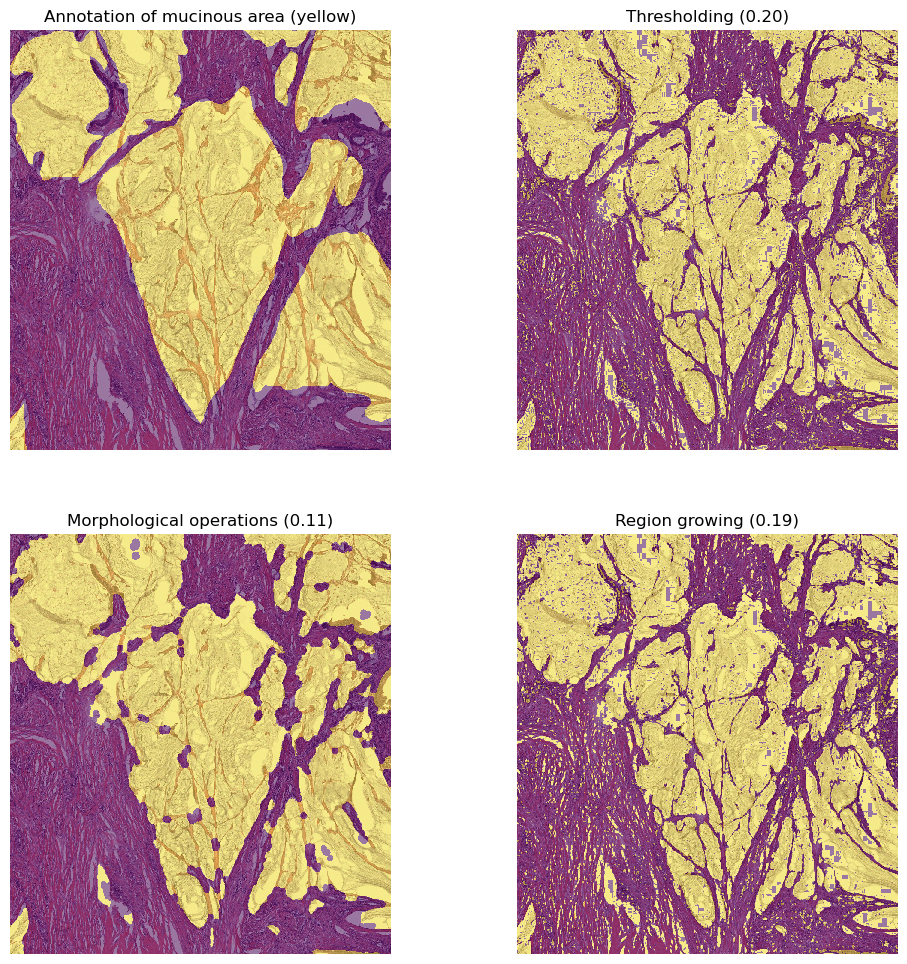

In [13]:
img_src = adeno_hsv[:, :, 0]
seeds = [(200, 200), (600, 650), (1200, 1150), (1050, 150), (700, 400)]

# Checking the real mask values are true in the above seeds 
for seed in seeds:
    print(adeno_gt[seed[1], seed[0]])

mask_region = region_growing(img_src, seeds, 0.80)  # This thereshold is chosen by trial and error.

print('error for region growing = {:4f}'.format(calc_err(mask_region, adeno_gt)))

# plot the results
# errors are shown in between paranthesis next to the titles
fig, ax = plt.subplots(2, 2, figsize=(12, 12))
ax[0, 0].imshow(adeno_img, interpolation='nearest')
ax[0, 0].imshow(adeno_gt, alpha=0.5, interpolation='nearest')
ax[0, 0].set_title('Annotation of mucinous area (yellow)')
ax[0, 0].axis('off')
ax[0, 1].imshow(adeno_img, interpolation='nearest')    
ax[0, 1].imshow(mask_thresholding, alpha=0.5, interpolation='nearest')
ax[0, 1].set_title('Thresholding ({:.2f})'.format(calc_err(mask_thresholding, adeno_gt)))
ax[0, 1].axis('off')
ax[1, 0].imshow(adeno_img, interpolation='nearest')
ax[1, 0].imshow(mask_morph, alpha=0.5, interpolation='nearest')
ax[1, 0].set_title('Morphological operations ({:.2f})'.format(calc_err(mask_morph, adeno_gt)))
ax[1, 0].axis('off')
ax[1, 1].imshow(adeno_img, interpolation='nearest')
ax[1, 1].imshow(mask_region, alpha=0.5, interpolation='nearest')
ax[1, 1].set_title('Region growing ({:.2f})'.format(calc_err(mask_region, adeno_gt)))
ax[1, 1].axis('off')
plt.show()

---
### 1.5 Method comparison (1pt)

In this section we display the overall outputs. Please make sure that you create the variables `mask_thesholding`, `mask_morph`, and `mask_region` to properly display the output. Comment on the results and what you think would be the best approach.

In [14]:
# Add your comments here

**Our Conclusion:** Through experimentation with various segmentation techniques, we have determined that utilizing a robust thresholding method in combination with mask morphology results in the most optimal outcomes compared to other methods. Although employing only thresholding techniques produced satisfactory results, when used in tandem with mathematical morphology, performance have significantly enhanced. Additionally, our implementation of region growing was found to be effective, but the combination of thresholding and morphology proved to be the most successful approach.

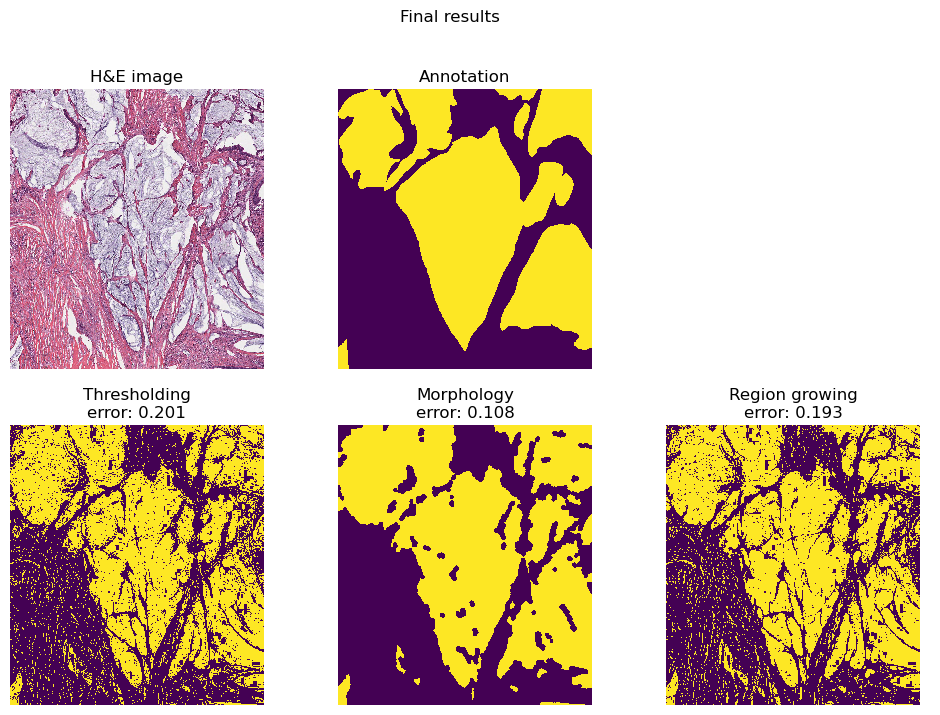

In [15]:
error_th = 1 - (mask_thresholding == adeno_gt).mean()
error_morph = 1 - (mask_morph == adeno_gt).mean()
error_region = 1 - (mask_region == adeno_gt).mean()

# displaying the MRI image
fig, ax = plt.subplots(2, 3, figsize=(12, 8))

# plotting the image
ax[0, 0].imshow(adeno_img, interpolation='nearest')
ax[0, 0].set_title('H&E image'.format(im_h, im_w))

# plotting the image with overlay
ax[0, 1].imshow(adeno_gt, interpolation='nearest')
ax[0, 1].set_title('Annotation')

# plotting the estimation using thresholding
ax[1, 0].imshow(mask_thresholding, interpolation='nearest')
ax[1, 0].set_title('Thresholding\nerror: {:.3f}'.format(error_th))

# plotting the estimation using contour detection
ax[1, 1].imshow(mask_morph, interpolation='nearest')
ax[1, 1].set_title('Morphology\nerror: {:.3f}'.format(error_morph))

# plotting the estimation using region growing
ax[1, 2].imshow(mask_region, interpolation='nearest')
ax[1, 2].set_title('Region growing\nerror: {:.3f}'.format(error_region))

[a.axis('off') for a in ax.ravel()]
plt.suptitle("Final results")
plt.show()

# ---
## Part 2: Axon segmentations (10 points)

#### Intro 

Axon segmentation is vital to neuroscience research as it enables the study of neurons' morphology and connectivity. We will conduct two exercises to evaluate the impact of your segmentation algorithms under different independent artefacts. Each exercise consists of a synthetic **Ground Truth (GT)** and two more images simulating a specific artifact.

The **Ground Truth**  has tree main compartments. 1) The inner part of the axon. 2) The outer layer of the axon (called myelin) and the extracellular slace (the background of the image). 

The task consists into segmenting the three main compartments in the image to compute the inner-axon and outer-axon radii distribution.


To compute the radii, we suggest the following approximation.
$$\hat{r}_{I}= \sqrt{\frac{A_{yellow}}{\pi}}$$
$$\hat{r}_{O}= \sqrt{\frac{A_{yellow} + A_{blue}}{\pi}}$$
Where **A** is the corresponding area of the comparments. 
**Using this image as reference** 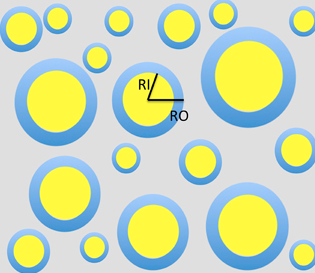

#### Artifacts simulated:

Excercise 1) Two images with different levels of SNR (signal to noise ratio). The images have rician noise.
Exercise  2) Two images adquired using a fraction of the fourier space. Only Lowest frequency are used to reconstruct the image. (simulating fast aquisitions in MRI)

Ensure your algorithm works on the GT before you go to the test cases with artifacts. Apply any preprocessing needed to the image. The preprocessing can be different for each type of image.

### Tasks

For each exercise we ask to:

1) Segment the images with the following colors: blue the inner part of the axon, red the outer part of the axon (myelin) and white for the backround(example) 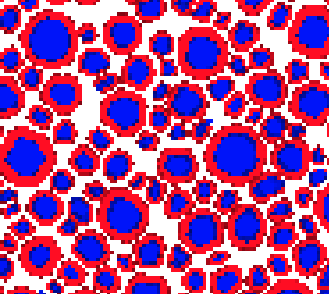

2) Count the number of axons obtained in the sample, calculate the radii for each axons, and display a radii histogram for the each of the images(GT and test cases).

In the exercises, assume that each pixel side is $(0.1 \mu m)$, i.e. a pixel has an area of $(0.01 \mu m^2 )$

## Grading 
The answers does not have to be perfect, they just be a good approximation.

1. Developing an algorithm that works for the two GT images. **(3 points)** 
2. Use preprosesing to prepare the images with SNR and the Low frequencies.  (**1 point** for SNR preprocesing , **1 point** for Low-frequency images preprocesing)
3. Running the algorithm in the test images. **1/2 point** SNR, **1/2 point** Low freqs
4. Computing and plotting radii distributions **(1 point)**
5. Explaining and discussing your implementation. **(3 points )**
    Try to be specific, not necessarily long. In the discussion include:
 1. What worked? 
 2. What did not work?
 3. Why do you think it does not work? 
 4. How could you improve your algorithms as future work?  Try to avoid general comments like "using deep learning" 
 
**Extra points: Real data example (3 points), the algorithm should display a _good enough_ segmentation.**

### 2.1 SNR

In [16]:
data_base_path

'..\\data'

..\data


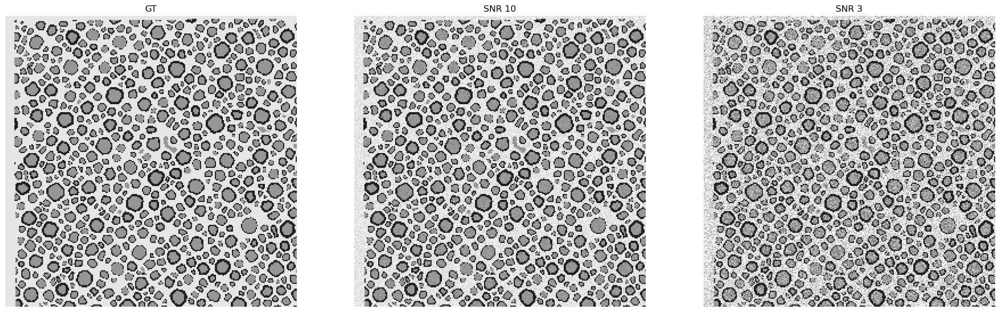

In [17]:
data_base_path = os.path.join(os.pardir, 'data')
print(data_base_path)
data_folder = 'lab-01-data'

path_folder = os.path.join(data_base_path, data_folder) + '/' 

files = ["GT_0.png"  , "test_0_0.png" , "test_0_1.png"]
gt_0 = cv2.imread(path_folder+ files[0])
snr_10 = cv2.imread(path_folder+ files[1])
snr_3 = cv2.imread(path_folder+ files[2])

images = [gt_0, snr_10, snr_3]
im_names = ["GT" , "SNR 10" , "SNR 3"]
fig, axes = plt.subplots(1, 3, figsize=(24, 12))
for ax, im, nm in zip(axes.ravel(), images, im_names):
    ax.imshow(im[0:512,0:512])
    ax.axis('off')
    ax.set_title(nm)
plt.show()

In [18]:
# Since the images are in gray scale, all of their channels are the same. So, we choose the first one for our computations.
gt_0_gray = gt_0[:,:,0]
snr_10_gray = snr_10[:,:,0]
snr_3_gray = snr_3[:,:,0]

### 2.1.1 Preprocessing 

Preprocessing is one of the most important step in every computer vision task. Since the test images are corrupted by noise, denoising is a vital process before doing any other tasks. 

To deal with this issue, we used different denoisers such as **total variation, wavelet, and bilateral filtering.** Note that bilateral filtering is significantly slower than other methods.

We then evaluated the denoisers performance by **peak signal noise ratio (PSNR)**. Higher PSNR means better performance. Then, The best denoised images which is obtained by the wavelet.

Finally, we applied the gaussian filtering after finding the best denoised images. The reason for applying Gaussian filter is to further smooth images. Also, we chose sigma by trial and error.

In [19]:
# applying the total variation denoiser
# from skimage.restoration import denoise_tv_chambolle
#denoised_10_tv = denoise_tv_chambolle(snr_10_gray, weight=0.2, channel_axis=None)
#denoised_10_tv = img_as_ubyte(denoised_10_tv)
#denoised_3_tv = denoise_tv_chambolle(snr_3_gray, weight=0.2, channel_axis=None)
#denoised_3_tv = img_as_ubyte(denoised_3_tv)

# applying bilateral filtering
# from skimage.restoration import denoise_bilateral
#denoised_10_bilateral = denoise_bilateral(snr_10_gray, sigma_color=0.1, sigma_spatial=15, channel_axis=-1)
#denoised_3_bilateral = denoise_bilateral(snr_3_gray, sigma_color=0.1, sigma_spatial=15, channel_axis=-1)
#denoised_3_bilateral = img_as_ubyte(denoised_3_bilateral)
#denoised_10_bilateral = img_as_ubyte(denoised_10_bilateral)

# applying the wavelet denoiser
#sigma_est_10 = estimate_sigma(snr_10_gray, channel_axis=-1, average_sigmas=True)   
#sigma_est_3 = estimate_sigma(snr_3_gray, channel_axis=-1, average_sigmas=True)

denoised_10_wavelet = denoise_wavelet(snr_10_gray, channel_axis=-1, rescale_sigma=True)
denoised_10_wavelet = img_as_ubyte(denoised_10_wavelet)
denoised_3_wavelet = denoise_wavelet(snr_3_gray, channel_axis=-1, rescale_sigma=True)
denoised_3_wavelet = img_as_ubyte(denoised_3_wavelet)

denoised_10_gaussian = gaussian(denoised_10_wavelet, sigma=0.3)
denoised_10_gaussian = img_as_ubyte(denoised_10_gaussian)
denoised_3_gaussian = gaussian(denoised_3_wavelet, sigma=0.7)
denoised_3_gaussian = img_as_ubyte(denoised_3_gaussian)

# printing the results
print(f"PSNR for Wavelet in SNR 10 = {psnr(denoised_10_wavelet, gt_0_gray)}")
print(f"PSNR for Wavelet in SNR 3 = {psnr(denoised_3_wavelet, gt_0_gray)}")
print(f"PSNR for Gaussian Filtering on the Denoised Image by Wavelet in SNR 10 = {psnr(denoised_10_gaussian, gt_0_gray)}")
print(f"PSNR for Gaussian Filtering on the Denoised Image by Wavelet in SNR 3 = {psnr(denoised_3_gaussian, gt_0_gray)}")

PSNR for Wavelet in SNR 10 = 26.70400173442758
PSNR for Wavelet in SNR 3 = 18.32819706831639
PSNR for Gaussian Filtering on the Denoised Image by Wavelet in SNR 10 = 26.73249960823626
PSNR for Gaussian Filtering on the Denoised Image by Wavelet in SNR 3 = 17.282154596817563


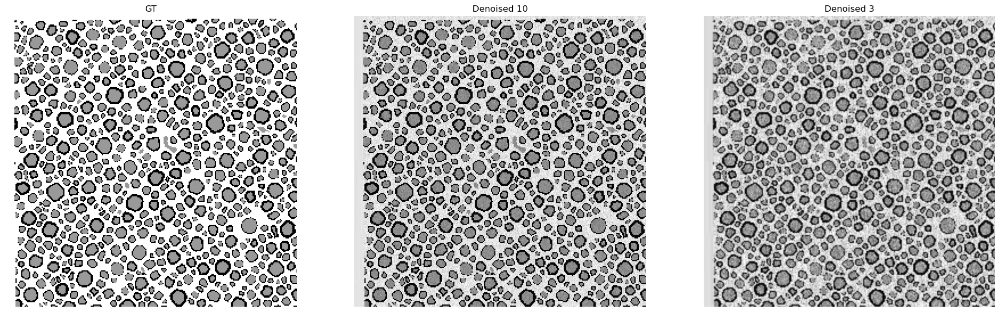

In [20]:
# assign the best final results
denoised_10 = denoised_10_gaussian
denoised_3 = denoised_3_gaussian

images = [gt_0_gray, denoised_10, denoised_3]
im_names = ["GT" , "Denoised 10" , "Denoised 3"]
fig, axes = plt.subplots(1, 3, figsize=(24, 12))
for ax, im, nm in zip(axes.ravel(), images, im_names):
    ax.imshow(im[0:512,0:512], cmap = 'gray')
    ax.axis('off')
    ax.set_title(nm)
plt.show()

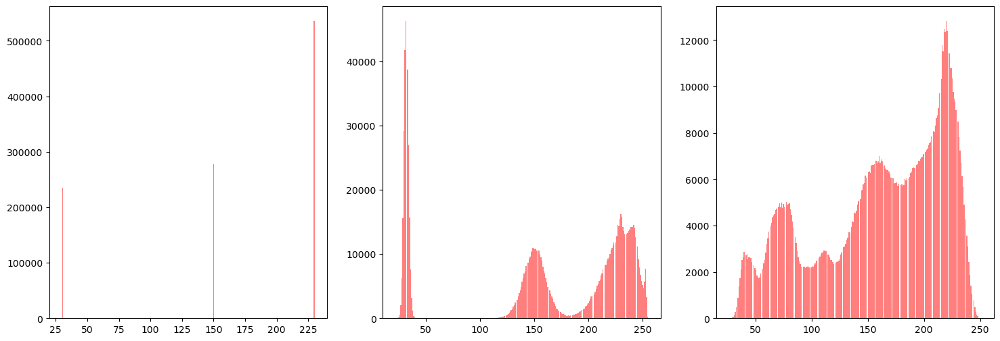

In [21]:
# histogram visualization
img_arr = [gt_0_gray, denoised_10, denoised_3]
fig, ax = plt.subplots(1, 3, figsize=(18, 6))
for i in range(3):
    ax[i].hist(img_arr[i].ravel(), bins=256, color='red', alpha=0.5)
plt.show()


### 2.1.2 Results Segmetations

**Our Algorithm for Segmentation:**

By using theresholding, considering the visualized histograms, we constructed the output RGB image. More specefically, as required, we mapped the black pixels to red, gray to blue, and white to white.

In [22]:
def map_value_for_red(value):
    if value <= 90 or value >= 190:
        return 255
    else:
        return 0

def map_value_for_blue(value):
    if  value < 190 and value > 90 or value >= 190:
        return 255
    else:
        return 0

def map_value_for_green(value):
    if value >= 190:
        return 255
    else:
        return 0

def segment(img):
    mapped_array_red = np.vectorize(map_value_for_red)(img)
    mapped_array_green = np.vectorize(map_value_for_green)(img)
    mapped_array_blue = np.vectorize(map_value_for_blue)(img)
    mapped_array_red = np.expand_dims(mapped_array_red, axis=2)
    mapped_array_blue = np.expand_dims(mapped_array_blue, axis=2)
    mapped_array_green = np.expand_dims(mapped_array_green, axis=2)
    return np.concatenate((mapped_array_red, mapped_array_green, mapped_array_blue), axis=2)

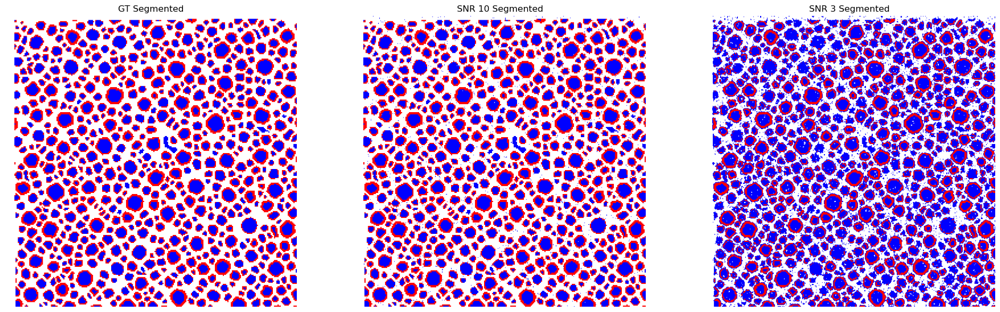

In [23]:
gt_0_segmented = segment(gt_0_gray)
denoised_10_segmented = segment(denoised_10)
denoised_3_segmented = segment(denoised_3)

images = [gt_0_segmented , denoised_10_segmented, denoised_3_segmented]
im_names = ["GT Segmented" , "SNR 10 Segmented" , "SNR 3 Segmented"]
fig, axes = plt.subplots(1, 3, figsize=(24, 24))
for ax, im, nm in zip(axes.ravel(), images, im_names):
    ax.imshow(im[0:512,0:512])
    ax.axis('off')
    ax.set_title(nm)
plt.show()

As you can see from the above figures, our segmentation algorithm works very well. In addition to visualization, we also calculate error quantitatively. As you can see, the error is very small which demostrate the effectiveness of our segmentation and preprocessing algorithms.

In [24]:
#Calculate error for segmentation

error_10 = []
for i in range(3):
    error_10.append(calc_err(denoised_10_segmented[:,:,i],gt_0_segmented[:,:,i]))
average_10 = np.mean(np.array(error_10))
print(f"Error for SNR 10: {average_10}")

error_3 = []
for i in range(3):
    error_3.append(calc_err(denoised_3_segmented[:,:,i],gt_0_segmented[:,:,i]))
average_3 = np.mean(np.array(error_3))
print(f"Error for SNR 10: {average_3}")

Error for SNR 10: 0.003238677978515625
Error for SNR 10: 0.11240895589192708


**Our Algorithm for Calculting Areas**

Here, in this part we means number of *pixels* by the word *area*.

Sufficient comments are added into the function. However, as an overview, the whole idea is to find the contours corresponding to the black boundaries and calculate the number of gray and black pixels that lay inside the contour. Note that, we assume each axon has an inner part (gray) and a boundary (black). In other words, the axons that appear only as gray are ignored.

One way to do this, is using the commented piece of code given below. However, it is so slow, as it requires looping across the whole image twice (for both x and y directions). Our `calc_areas` function is optimized by using a mask instead of the given nested for loops below.

In [25]:
# for y in range(image.shape[0]):
#     for x in range(image.shape[1]):
#         if cv2.pointPolygonTest(contour, (x, y), False) > 0:
#             if gt_0_gray[y, x] == 150:     # a range corresponding to gray
#                 gray_area += 1
#                 gray_black_area += 1
#             elif gt_0_gray[y, x] == 30:    # a range corresponding to black
#                 gray_black_area += 1

In [26]:
def calc_areas(img_thresholded, img_gray, img_colored, threshold_black, threshold_gray, roi_size=5):
    """
    img_thresholded (containing the whole axons) is used to find the contours. 
    img_gray is the original single-channel gray-scale image.
    the identified contours are drawn on img_colored with green color.
    threshold_black and thresold_gray are used to assume a range for black and gray pixels, respectively.
    roi_size can be changed to other values as well.
    """
    
    contours, hierarchy = cv2.findContours(img_thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    inner_areas = []
    whole_areas = []
    for contour in contours:
        has_black_neighbor = False
        
        # looping through the contour pixels and check whether any of them is black.
        # in case, there is a black pixel, stop the loop to increase the speed.
        # note the image_thresholded is the binarized version of the original image where the whole
        # axons (both inner gray parts and black boundaries) are extratced. therefore, the contour
        # should contain a black pixel since it corresponds to the outer edge of the axon, i.e.,
        # its boundary.
        for pixel in contour:
            x, y = pixel[0]
            if img_gray[y, x] < threshold_black: 
                has_black_neighbor = True
                break

        # if the contour has a black pixel, we continue calculating the areas (number of pixels) of the both
        # inner gray part and black boundaries. this way, we make sure, we have the one-to-one correspondence
        # between the inner parts and boundaries.
        if has_black_neighbor:
            cv2.drawContours(img_colored, [contour], 0, (0, 255, 0), 2)
            gray_area = 0
            gray_black_area = 0
            
            # the mask below is used instead of the nest for loops as described before.
            mask = np.zeros_like(img_gray)
            cv2.drawContours(mask, [contour], 0, 255, -1)
            
            # disregarding the contour itself from the mask
            for pixel in contour:
                x, y = pixel[0]
                mask[y, x] = 0
            
            if len(contour) == 1: # handling the case when the countour is only one pixel
                roi_min = contour[0][0]
                roi_max = contour[0][0]
            else:
                roi_min = np.squeeze(np.maximum(contour.min(axis=0) - roi_size, 0))
                roi_max = np.squeeze(np.minimum(contour.max(axis=0) + roi_size,
                                                np.array([img_gray.shape[1], img_gray.shape[0]]) - roi_size))
                roi_max = np.squeeze(np.maximum(roi_max, roi_min))
                
            # make sure the calculated roi (region of interest) is with the image boundary
            if roi_min[1] < img_gray.shape[0] and roi_max[1] > 0 and roi_min[0] < img_gray.shape[1] and roi_max[0] > 0:
                # extracting the roi of the mask
                roi_mask = mask[roi_min[1]:roi_max[1]+roi_size, roi_min[0]:roi_max[0]+roi_size]
                # extracting the roi of the original image
                roi_gray = img_gray[roi_min[1]:roi_max[1]+roi_size, roi_min[0]:roi_max[0]+roi_size]
                # the roi_mask==255 condition is to make sure we do not count the intersection of
                # regions of interests several times
                gray_pixels = np.where((roi_mask == 255) & (roi_gray >= threshold_black) & (roi_gray <= threshold_gray))
                gray_area = len(gray_pixels[0])
                gray_black_pixels = np.where((roi_mask == 255) & (roi_gray <= threshold_gray))
                gray_black_area = len(gray_black_pixels[0])
                inner_areas.append(gray_area)
                whole_areas.append(gray_black_area)
    inner_areas = np.array(inner_areas)
    whole_areas = np.array(whole_areas)
    # removing the 0 elements
    temp = (inner_areas == 0)
    inner_areas = inner_areas[~temp]
    whole_areas = whole_areas[~temp]
    return inner_areas, whole_areas, img_colored.astype(np.uint8)

GT: inner area=2656, out area=2656
Denoised 10: inner area=2646, out area=2646
Denoised 3: inner area=1817, out area=1817


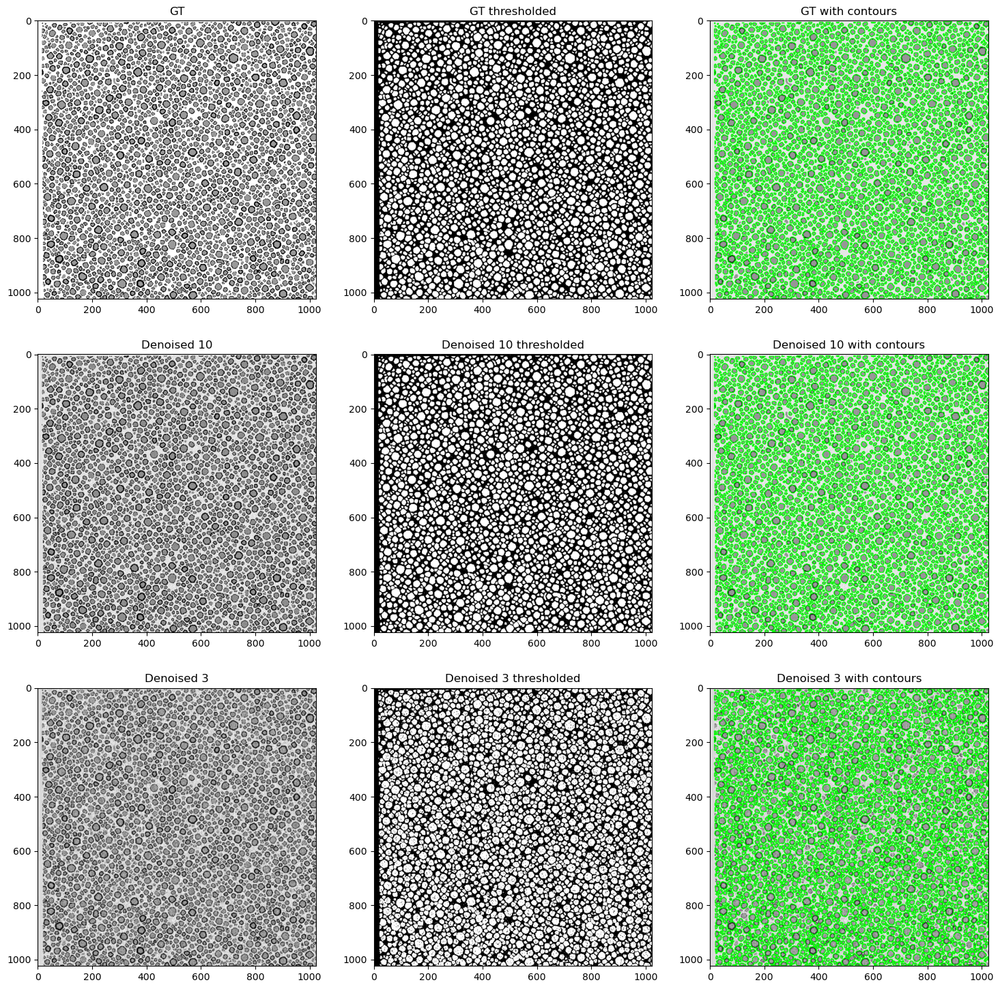

In [27]:
# all the thresholding numbers defined below are found by trial and error and histogram visualization

gt_0_thresholded = cv2.inRange(gt_0_gray, 0, 190)  
gt_0_inner_areas, gt_0_whole_areas, gt_0_colored = calc_areas(gt_0_thresholded, gt_0_gray, gt_0.copy(), 90, 190, 5)

denoised_10_colored = np.zeros((denoised_10.shape[0], denoised_10.shape[1], 3))
denoised_10_colored[:,:,0] = denoised_10
denoised_10_colored[:,:,1] = denoised_10
denoised_10_colored[:,:,2] = denoised_10
denoised_10_thresholded = cv2.inRange(denoised_10, 0, 190) 
denoised_10_inner_areas, denoised_10_whole_areas, denoised_10_colored = calc_areas(denoised_10_thresholded, denoised_10, 
                                                                                   denoised_10_colored, 90, 190, 5)

denoised_3_colored = np.zeros((denoised_3.shape[0], denoised_3.shape[1], 3))
denoised_3_colored[:,:,0] = denoised_3
denoised_3_colored[:,:,1] = denoised_3
denoised_3_colored[:,:,2] = denoised_3
denoised_3_thresholded = cv2.inRange(denoised_3, 0, 180)
denoised_3_inner_areas, denoised_3_whole_areas, denoised_3_colored = calc_areas(denoised_3_thresholded, denoised_3,
                                                                                denoised_3_colored, 90, 190, 5)

print('GT: inner area={:d}, out area={:d}'.format(len(gt_0_inner_areas), len(gt_0_whole_areas)))
print('Denoised 10: inner area={:d}, out area={:d}'.format(len(denoised_10_inner_areas), len(denoised_10_whole_areas)))
print('Denoised 3: inner area={:d}, out area={:d}'.format(len(denoised_3_inner_areas), len(denoised_3_whole_areas)))

gt_0_arr = [gt_0_gray, gt_0_thresholded, gt_0_colored]
denoised_10_arr = [denoised_10, denoised_10_thresholded, denoised_10_colored]
denoised_3_arr = [denoised_3, denoised_3_thresholded, denoised_3_colored]
img_arr = [gt_0_arr, denoised_10_arr, denoised_3_arr]
title_arr = ['GT', 'Denoised 10', 'Denoised 3']
subtitle_arr = ['', ' thresholded', ' with contours']
fig, ax = plt.subplots(3, 3, figsize=(18, 18))
for i in range(3):
    for j in range(3):
        ax[i, j].imshow(img_arr[i][j], cmap='gray')
        ax[i, j].set_title(title_arr[i]+subtitle_arr[j])
plt.show()

### 2.1.3 Radii histrograms 

In [28]:
def calc_radii(areas, pixel_area=0.01):
    return np.sqrt(areas*pixel_area/np.pi)

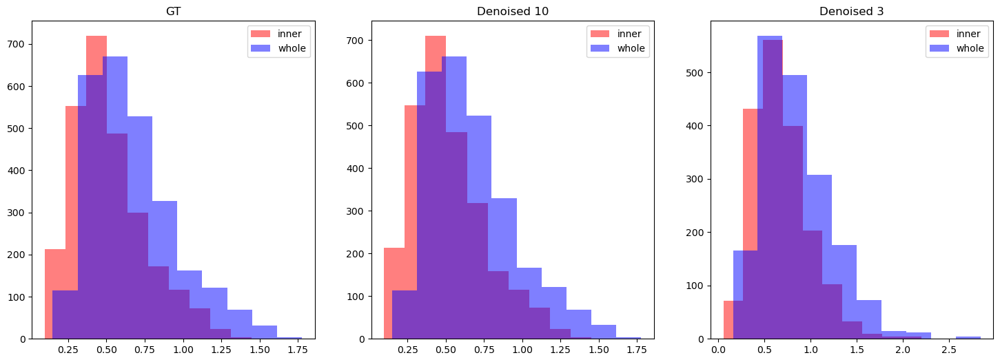

In [29]:
pixel_area = 0.01
gt_0_inner_radii = calc_radii(gt_0_inner_areas, pixel_area)
gt_0_whole_radii = calc_radii(gt_0_whole_areas, pixel_area)
denoised_10_inner_radii = calc_radii(denoised_10_inner_areas, pixel_area)
denoised_10_whole_radii = calc_radii(denoised_10_whole_areas, pixel_area)
denoised_3_inner_radii = calc_radii(denoised_3_inner_areas, pixel_area)
denoised_3_whole_radii = calc_radii(denoised_3_whole_areas, pixel_area)

gt_0_radii_arr = [gt_0_inner_radii, gt_0_whole_radii]
denoised_10_radii_arr = [denoised_10_inner_radii, denoised_10_whole_radii]
denoised_3_radii_arr = [denoised_3_inner_radii, denoised_3_whole_radii]
radii_arr = [gt_0_radii_arr, denoised_10_radii_arr, denoised_3_radii_arr]
im_names = ["GT" , "Denoised 10" , "Denoised 3"]
fig, ax = plt.subplots(1, 3, figsize=(18, 6))
for i in range(3):
    ax[i].hist(radii_arr[i][0], color='r', alpha=0.5, label='inner')
    ax[i].hist(radii_arr[i][1], color='b', alpha=0.5, label='whole')
    ax[i].legend()
    ax[i].set_title(im_names[i])
plt.show()

As you can see, the radii distributions show a reasonable spread. Also, as expected, the *whole* area is bigger than *inner* area (shifted to right). 

### 2.2 Low frequencies

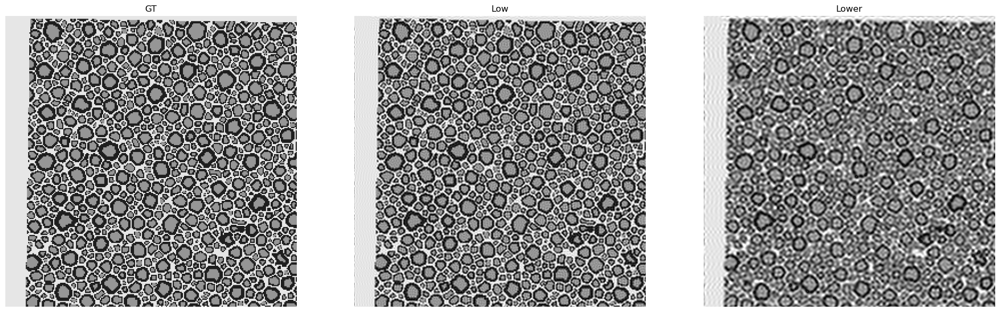

In [30]:
files = ["GT_3.png"  , "test_3_0.png" , "test_3_1.png"]
path = "data/"
gt_3 = cv2.imread(path_folder+ files[0])
lowfreq0 = cv2.imread(path_folder+ files[1])
lowfreq1 = cv2.imread(path_folder+ files[2])

images = [gt_3 , lowfreq0, lowfreq1]
im_names = ["GT" , "Low" , "Lower"]
fig, axes = plt.subplots(1, 3, figsize=(24, 24))
for ax, im, nm in zip(axes.ravel(), images, im_names):
    ax.imshow(im[0:512,0:512])
    ax.axis('off')
    ax.set_title(nm)
plt.show()

### 2.2.1 Preprocessing


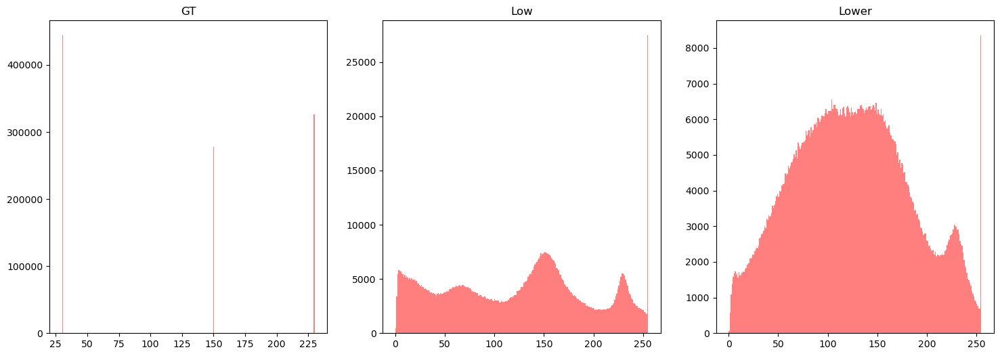

In [31]:
gt_3_gray = gt_3[:, :, 0]
lowfreq0_gray = lowfreq0[:, :, 0]
lowfreq1_gray = lowfreq1[:, :, 0]

# Histogram visualization
img_arr = [gt_3_gray, lowfreq0_gray, lowfreq1_gray]
fig, ax = plt.subplots(1, 3, figsize=(18, 6))
im_names = ["GT" , "Low" , "Lower"]
for i in range(3):
    ax[i].hist(img_arr[i].ravel(), bins=256, color='red', alpha=0.5)
    ax[i].set_title(im_names[i])
plt.show()

We tried many different techniques to reconstruct the images based on given blurry images. Among all methods we tried, we found that *Multi-Otsu Thresholding* performs slightly better than unprocessed images. However, we observed that without preproessing, our segmentation algorithm can do a descent job on the low-frequency (lowfreq0). On the other hand, the lower-frequency (lowfreq1) image is quite degraded, and we need to perform some additional steps to better calculate the areas. 

We tried a bunch a different methods commented in the cell below. In summary, these methods are as follows:

- Using different deconvolution algorithms such as Wiener filtering and Richardson–Lucy
- Each of the deconvolution algorithms needs point spread function (PSF) or Gaussian kernel.
- Sharpening
- Smoothing
- Using high-pass filter with different kernels and sizes
- Using famous filtering methods such as butterworth
- Applying fourier transform and manipulating the frequencies
- Using edge-detection algorithms such as sobel and roberts
- General filtering algorithms such as median filtering and mean filtering

In [32]:
# from skimage.filters import median, unsharp_mask, sobel, roberts, butterworth, wiener
# from skimage.restoration import unsupervised_wiener
# from scipy.signal import convolve2d

# lowfreq1_gray = lowfreq1[:, :, 0]
# f = np.fft.fft2(lowfreq1_gray)
# fshift = np.fft.fftshift(f)
# rows, cols = lowfreq1_gray.shape
# crow, ccol = rows//2, cols//2
# fshift[crow-2:crow+2, ccol-2:ccol+2] = 0  
# f_ishift = np.fft.ifftshift(fshift)
# lowfreq1_sharpened = np.abs(np.fft.ifft2(f_ishift))
# lowfreq1_sharpened = unsharp_mask(lowfreq1, radius=1, amount=5)*255

# freq_space = np.fft.fft2(lowfreq_1_gray)
# sampling_pattern = np.ones_like(freq_space, dtype=np.int)
# n = 64
# sampling_pattern[:n, :n] = 0
# sampling_pattern[-n:, :n] = 0
# sampling_pattern[:n, -n:] = 0
# sampling_pattern[-n:, -n:] = 0
# freq_components = np.fft.fftshift(freq_space) * sampling_pattern
# reconstructed_image = np.fft.ifft2(np.fft.ifftshift(freq_components))
# reconstructed_image = np.abs(reconstructed_image)
# temp = (reconstructed_image / np.max(reconstructed_image) * 255).astype(np.uint8)

# freq_space = np.fft.fft2(lowfreq_1_gray)
# freq_space[lowfreq_1_gray.shape[0]//2:, :] = 0
# freq_space[:, lowfreq_1_gray.shape[1]//2:] = 0
# reconstructed_image = np.fft.ifft2(freq_space)
# reconstructed_image = np.abs(reconstructed_image)
# reconstructed_image = (reconstructed_image / np.max(reconstructed_image) * 255).astype(np.uint8)

# rng = np.random.default_rng()
# lowfreq1_gray = lowfreq1[:, :, 0]
# psf = np.ones((5, 5)) / 25
# temp = convolve2d(lowfreq_1_gray, psf, 'same')
# print(temp.std())
# temp += 0.1 * temp.std() * rng.standard_normal(temp.shape)
# deconvolved, _ = unsupervised_wiener(temp, psf)

# temp = median(lowfreq_1_gray, footprint=np.ones((3, 3)))
# temp = roberts(lowfreq1[:,:,0])
# lowfreq_1_butter = butterworth(lowfreq_1_gray, cutoff_frequency_ratio=0.01, order=4, high_pass=True)
#sharpen_filter=np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])

# Some high-pass filter for trying
#kernel1 = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
#kernel2 = (-1/256)*np.array([[1, 4, 6, 4, 1], [4, 16, 24, 16, 4], [6, 24, 36, 24, 6], [6, 24, -476, 24, 6], [4, 16, 24, 16, 4], [1 , 4, 6, 4, 1]])

# Some Low Pass filter to see we can detect blur kernel or not
#psf1 = np.ones((5, 5)) / 25
#psf2 = np.ones((3, 3)) / 9

# def gkern2(kernlen=21, nsig=3):
#     """Returns a 2D Gaussian kernel array."""
#     interval = (2*nsig+1.)/(kernlen)
#     x = np.linspace(-nsig-interval/2., nsig+interval/2., kernlen+1)
#     kern1d = np.diff(st.norm.cdf(x))
#     kernel_raw = np.sqrt(np.outer(kern1d, kern1d))
#     kernel = kernel_raw/kernel_raw.sum()
#     return kernel
#psf3 = gkern2(26, 1)

#modified_lowfreq1, _ = restoration.unsupervised_wiener(lowfreq1[:,:,0], psf3)
#modified_lowfreq1 = modified_lowfreq1.astype(np.uint8)
#modified_lowfreq1 = convolve2d(lowfreq1[:,:,0], kernel2)
#modified_lowfreq0 = modified_lowfreq0.astype(np.uint8)
#sigma_est_lowfreq1 = estimate_sigma(lowfreq1, channel_axis=-1, average_sigmas=True)    #Noise Estimation
#modified_lowfreq1 = denoise_wavelet(lowfreq1, channel_axis=-1, rescale_sigma=True)
#modified_lowfreq1 = modified_lowfreq1.astype(np.uint8)
#modified_lowfreq1 = denoise_tv_chambolle(lowfreq1, weight=0.01, channel_axis=None)
#modified_lowfreq1= img_as_ubyte(modified_lowfreq1)
#modifiled_lowfreq1 = skimage.filters.gaussian(lowfreq1, sigma=1)
#modifiled_lowfreq1 = img_as_ubyte(modifiled_lowfreq1)
#modifiled_lowfreq1_segmented = segment(modifiled_lowfreq1[:,:,0])
#modifiled_lowfreq1=cv2.filter2D(lowfreq1[:,:,0],-1,sharpen_filter)

### 2.2.2 Results Segmetations

First, we directly apply our segmentation algorithm to the unprocessed images. As you can see and as mentioned earlier, our algorithm works decently on the low-frequency (lowfreq0) and also on the ground-truth. However, for lower-frequency (lowfreq1) is less precise. For this reason, we will apply `threshold_multiotsu` later on. 

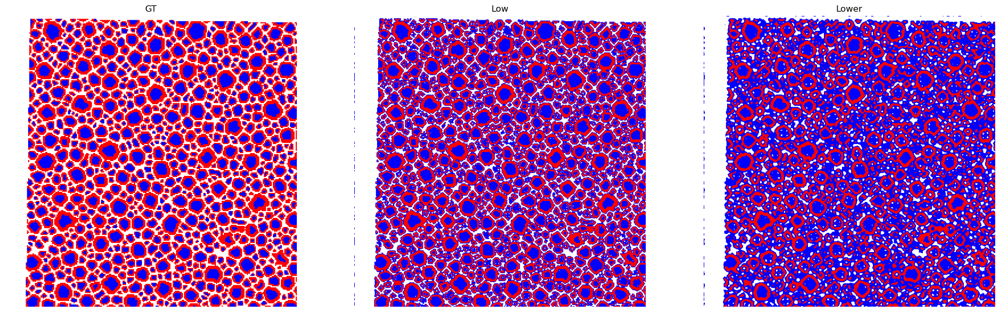

In [33]:
gt_3_segmented = segment(gt_3_gray)
lowfreq0_segmented = segment(lowfreq0_gray)
lowfreq1_segmented = segment(lowfreq1_gray)

images = [gt_3_segmented , lowfreq0_segmented, lowfreq1_segmented]
im_names = ["GT" , "Low" , "Lower"]
fig, axes = plt.subplots(1, 3, figsize=(24, 24))
for ax, im, nm in zip(axes.ravel(), images, im_names):
    ax.imshow(im[0:512,0:512])
    ax.axis('off')
    ax.set_title(nm)
plt.show()

In [34]:
#Calculate error for segmentation

error_low_unprocessed = []
for i in range(3):
    error_low_unprocessed.append(calc_err(lowfreq0_segmented[:,:,i],gt_3_segmented[:,:,i]))
average_low = np.mean(np.array(error_low_unprocessed))
print(f"Error for Low (Unprocessed): {average_low}")

error_lower_unprocessed = []
for i in range(3):
    error_lower_unprocessed.append(calc_err(lowfreq1_segmented[:,:,i],gt_3_segmented[:,:,i]))
average_lower = np.mean(np.array(error_lower_unprocessed))
print(f"Error for Lower (Unprocessed): {average_lower}")

Error for Low (Unprocessed): 0.13976160685221353
Error for Lower (Unprocessed): 0.27858416239420575


The error for low-frequency (lowfreq0) is small; however, that of lower-frequency (lowfreq1) is above 20%.

We applied `threshold_multiotsu` to the lower-frequency (lowfreq1) image.

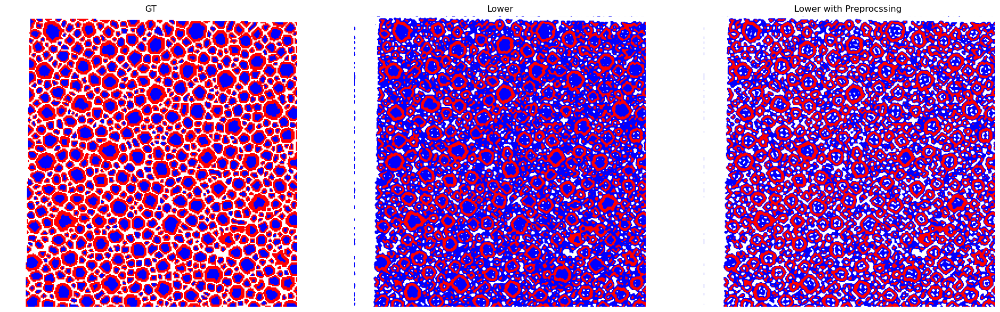

In [35]:
thresholds = threshold_multiotsu(lowfreq1_gray)
regions = np.digitize(lowfreq1_gray, bins=thresholds)
modified_lowfreq1 = regions * 127
modified_lowfreq1_segmented = segment(modified_lowfreq1)

images = [gt_3_segmented, lowfreq1_segmented, modified_lowfreq1_segmented]
im_names = ["GT", "Lower", "Lower with Preprocssing "]
fig, axes = plt.subplots(1, 3, figsize=(24, 24))
for ax, im, nm in zip(axes.ravel(), images, im_names):
    ax.imshow(im[0:512,0:512])
    ax.axis('off')
    ax.set_title(nm)
plt.show()

In [36]:
error_lower_processed = []
for i in range(3):
    error_lower_processed.append(calc_err(modified_lowfreq1_segmented[:,:,i],gt_3_segmented[:,:,i]))
average_lower = np.mean(np.array(error_lower_processed))
print(f"Error for Lower (Processed): {average_lower}")

Error for Lower (Processed): 0.2612311045328776


With some preprocessing, the error of lower-frequency (lowfreq1) is slightly decreased.

GT: inner area=2929, out area=2929
Low: inner area=2313, out area=2313
Lower: inner area=1064, out area=1064


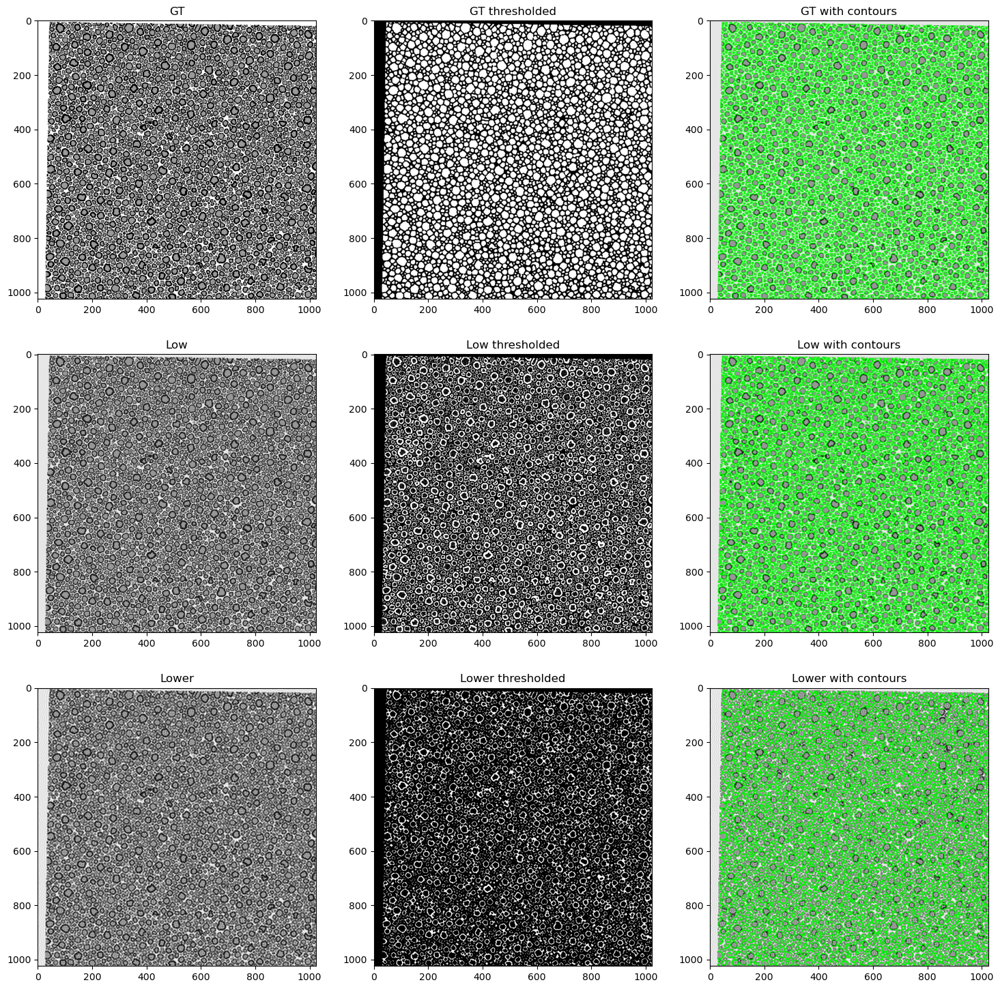

In [37]:
# all the thresholding numbers defined below are found by trial and error and histogram visualization

# Generating the cross structuring element
structuring_element = np.ones((3, 3), dtype=bool)
structuring_element[0, 0] = 0
structuring_element[0, 2] = 0
structuring_element[2, 0] = 0
structuring_element[2, 2] = 0

gt_3_thresholded = cv2.inRange(gt_3_gray, 0, 190)
gt_3_thresholded = binary_erosion(gt_3_thresholded, structuring_element)
gt_3_thresholded = gt_3_thresholded.astype(np.uint8)
gt_3_inner_areas, gt_3_whole_areas, gt_3_colored = calc_areas(gt_3_thresholded, gt_3_gray, gt_3.copy(), 90, 190, 5)

lowfreq0_colored = np.zeros((lowfreq0.shape[0], lowfreq0.shape[1], 3))
lowfreq0_colored[:,:,0] = lowfreq0_gray
lowfreq0_colored[:,:,1] = lowfreq0_gray
lowfreq0_colored[:,:,2] = lowfreq0_gray
lowfreq0_thresholded = cv2.inRange(lowfreq0_gray, 0, 150)
lowfreq0_thresholded = binary_erosion(lowfreq0_thresholded, structuring_element)
lowfreq0_thresholded = lowfreq0_thresholded.astype(np.uint8)*255
lowfreq0_inner_areas, lowfreq0_whole_areas, lowfreq0_colored = calc_areas(lowfreq0_thresholded, lowfreq0_gray,
                                                                          lowfreq0_colored, 90, 190, 5)

lowfreq1_colored = np.zeros((lowfreq1.shape[0], lowfreq1.shape[1], 3))
lowfreq1_colored[:,:,0] = lowfreq1_gray
lowfreq1_colored[:,:,1] = lowfreq1_gray
lowfreq1_colored[:,:,2] = lowfreq1_gray
lowfreq1_thresholded = cv2.inRange(lowfreq1_gray, 0, 130)
lowfreq1_thresholded = binary_erosion(lowfreq1_thresholded, structuring_element)
lowfreq1_thresholded = binary_erosion(lowfreq1_thresholded, structuring_element)
lowfreq1_thresholded = lowfreq1_thresholded.astype(np.uint8)*255
lowfreq1_inner_areas, lowfreq1_whole_areas, lowfreq1_colored = calc_areas(lowfreq1_thresholded, lowfreq1_gray,
                                                                          lowfreq1_colored, 90, 190, 5)

print('GT: inner area={:d}, out area={:d}'.format(len(gt_3_inner_areas), len(gt_3_whole_areas)))
print('Low: inner area={:d}, out area={:d}'.format(len(lowfreq0_inner_areas), len(lowfreq0_whole_areas)))
print('Lower: inner area={:d}, out area={:d}'.format(len(lowfreq1_inner_areas), len(lowfreq1_whole_areas)))

gt_3_arr = [gt_3_gray, gt_3_thresholded, gt_3_colored]
lowfreq0_arr = [lowfreq0_gray, lowfreq0_thresholded, lowfreq0_colored]
lowfreq1_arr = [lowfreq1_gray, lowfreq1_thresholded, lowfreq1_colored]
img_arr = [gt_3_arr, lowfreq0_arr, lowfreq1_arr]
title_arr = ['GT', 'Low', 'Lower']
subtitle_arr = ['', ' thresholded', ' with contours']
fig, ax = plt.subplots(3, 3, figsize=(18, 18))
for i in range(3):
    for j in range(3):
        ax[i, j].imshow(img_arr[i][j], cmap='gray')
        ax[i, j].set_title(title_arr[i]+subtitle_arr[j])
plt.show()

### 2.2.3 Radii histrograms

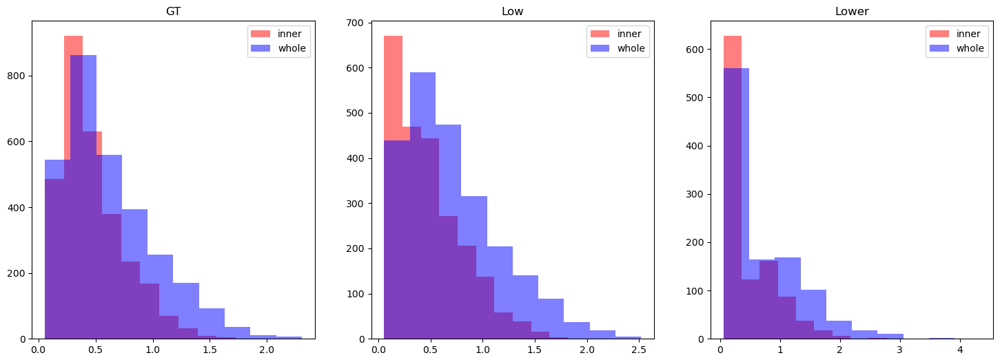

In [38]:
gt_3_inner_radii = calc_radii(gt_3_inner_areas, pixel_area)
gt_3_whole_radii = calc_radii(gt_3_whole_areas, pixel_area)
lowfreq0_inner_radii = calc_radii(lowfreq0_inner_areas, pixel_area)
lowfreq0_whole_radii = calc_radii(lowfreq0_whole_areas, pixel_area)
lowfreq1_inner_radii = calc_radii(lowfreq1_inner_areas, pixel_area)
lowfreq1_whole_radii = calc_radii(lowfreq1_whole_areas, pixel_area)

gt_3_radii_arr = [gt_3_inner_radii, gt_3_whole_radii]
lowfreq0_radii_arr = [lowfreq0_inner_radii, lowfreq0_whole_radii]
lowfreq1_radii_arr = [lowfreq1_inner_radii, lowfreq1_whole_radii]
radii_arr = [gt_3_radii_arr, lowfreq0_radii_arr, lowfreq1_radii_arr]
im_names = ["GT" , "Low" , "Lower"]
fig, ax = plt.subplots(1, 3, figsize=(18, 6))
for i in range(3):
    ax[i].hist(radii_arr[i][0], color='r', alpha=0.5, label='inner')
    ax[i].hist(radii_arr[i][1], color='b', alpha=0.5, label='whole')
    ax[i].legend()
    ax[i].set_title(im_names[i])
plt.show()

As you can see, the radii distributions of the ground truth and low-frequency (lowfreq0) show a reasonable spread which is in the same level as the radii distributions of denoised images. For the lower frequency (lowfreq1) the distribution is more broad and less precise for the reason mentioned earlier. Also, as expected, the *whole* area is bigger than *inner* area (shifted to right). 

### 2.5 Not mandatory exercise, Real data ( 3 points )

The points are given just by having a good enough segmentation.

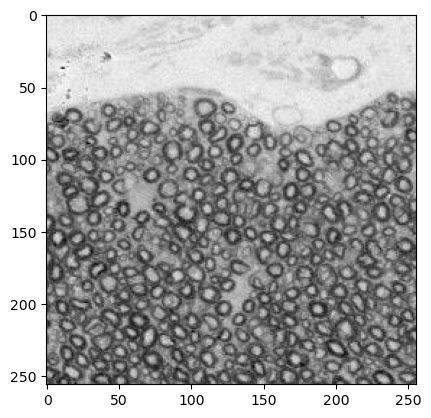

In [39]:
# Add your implementation and discussion
import cv2

files = ["extra_point.png" ]
real_data = cv2.imread(path_folder+ files[0])

plt.imshow(real_data[:256, :256])

For real data, we also applied multi Otsu thresholding as a preprocessing step. Then, we applied our segmentation algorithm and it works decently given the image condition.

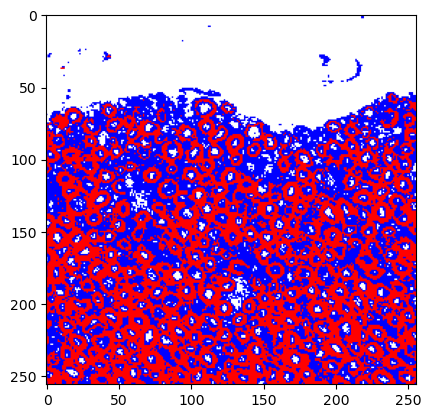

In [40]:
thereshold_value = threshold_multiotsu(real_data[:,:,0])
real_threshold = np.digitize(real_data, bins=thereshold_value)
real_segmented = segment(real_threshold[:,:,0] *127)
plt.imshow(real_segmented[:256, :256])